In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os

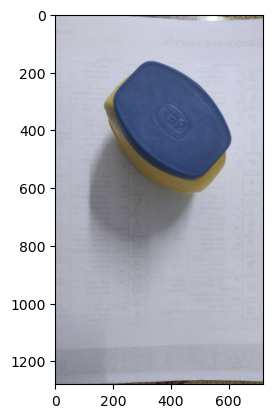

In [3]:
img = cv2.imread('img/03/simple_object_2.jpg')
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
plt.imshow(img)

In [4]:
def shadow_detection(image):

    lab_image = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)

    mean_l = np.mean(lab_image[:, :, 0])
    mean_a = np.mean(lab_image[:, :, 1])
    mean_b = np.mean(lab_image[:, :, 2])
    std_l = np.std(lab_image[:, :, 0])

    if mean_a + mean_b <= 256:
        shadow_mask = lab_image[:, :, 0] <= (mean_l - std_l/3)
    else:
        shadow_mask = (lab_image[:, :, 0] < mean_l) & (lab_image[:, :, 2] < mean_b)

    kernel = np.ones((3, 3), np.uint8)
    cleaned_mask = cv2.morphologyEx(shadow_mask.astype(np.uint8), cv2.MORPH_OPEN, kernel)

    shadow_mask_cleaned = cv2.dilate(cleaned_mask, kernel, iterations=1)
    shadow_mask_cleaned = cv2.erode(shadow_mask_cleaned, kernel, iterations=1)
    
    non_shadow_mask_cleaned = ~shadow_mask_cleaned

    result_image = np.copy(image)
    result_image[shadow_mask_cleaned] = [0,0,0]  

    return result_image, shadow_mask_cleaned

In [5]:
def shadow_remove(image, shadow_mask):
    image_float = image.astype(np.float32)

    shadow_pixels = np.where(shadow_mask)

    avg_rgb_inside_shadow = np.zeros((3,))
    avg_rgb_outside_shadow = np.zeros((3,))

    for channel in range(3):
        avg_rgb_inside_shadow[channel] = np.mean(image_float[shadow_pixels[0], shadow_pixels[1], channel])

    outside_shadow_mask = ~shadow_mask
    outside_shadow_pixels = np.where(outside_shadow_mask)
    
    for channel in range(3):
        avg_rgb_outside_shadow[channel] = np.mean(image_float[outside_shadow_pixels[0], outside_shadow_pixels[1], channel])

    constants = avg_rgb_outside_shadow / avg_rgb_inside_shadow

    for channel in range(3):
        image_float[shadow_pixels[0], shadow_pixels[1], channel] *= constants[channel]

    result_image = np.clip(image_float, 0, 255).astype(np.uint8)

    return result_image

Text(0.5, 1.0, 'final_result_img')

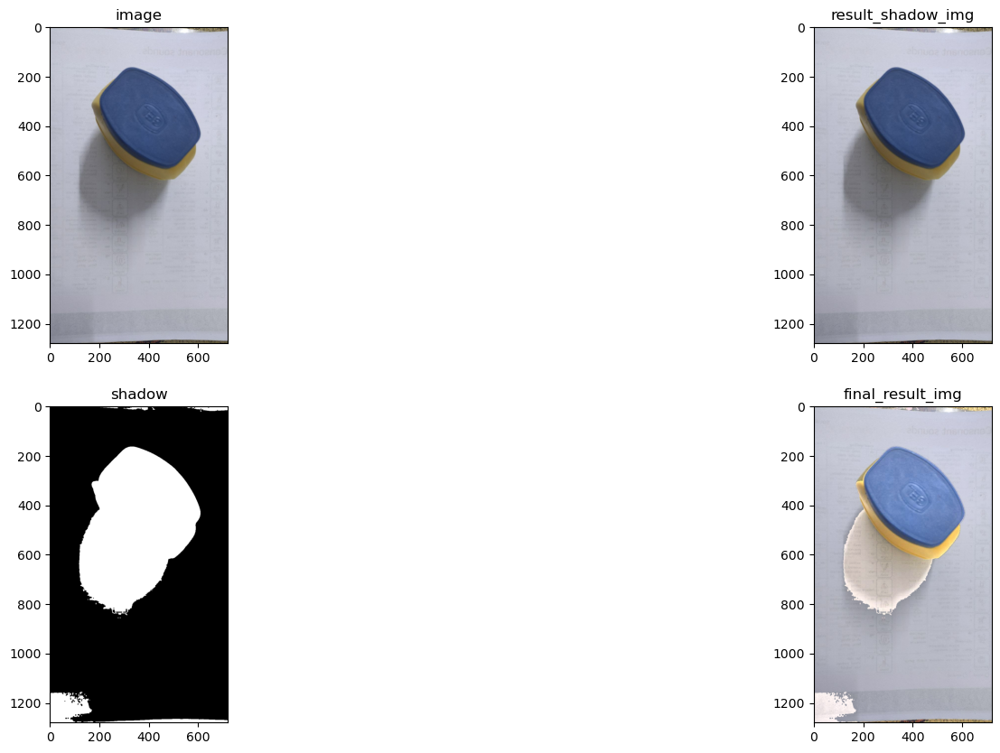

In [6]:
result_shadow_img, shadow_mask = shadow_detection(img)
final_result_img = shadow_remove(result_shadow_img,shadow_mask)

plt.figure(figsize=(20,10))

plt.subplot(2,2,1)
plt.imshow(img)
plt.title('image')

plt.subplot(2,2,2)
plt.imshow(result_shadow_img,cmap='gray')
plt.title('result_shadow_img')

plt.subplot(2,2,3)
plt.imshow(shadow_mask,cmap='gray')
plt.title('shadow')

plt.subplot(2,2,4)
plt.imshow(final_result_img,cmap='gray')
plt.title('final_result_img')

In [7]:
np.unique(result_shadow_img)

array([  0,   1,   3,   4,   6,   7,   8,   9,  10,  11,  12,  13,  14,
        15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,
        28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,
        41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,
        54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,
        67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,
        80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,
        93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104, 105,
       106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118,
       119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131,
       132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144,
       145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157,
       158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170,
       171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 18

In [8]:
frames_dir = '../dataset/frames/test/00062'

frame_files = sorted([os.path.join(frames_dir, f) for f in os.listdir(frames_dir) if f.endswith(('.jpg', '.png'))])

#  Background Model Initialization

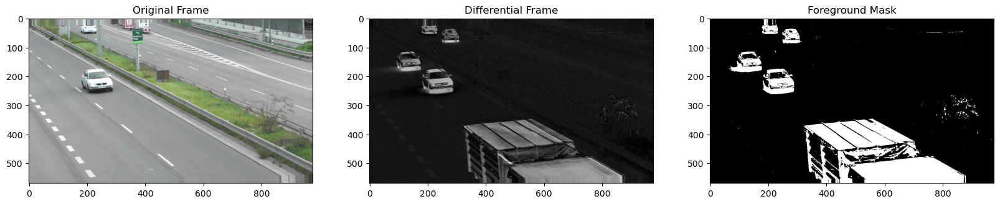

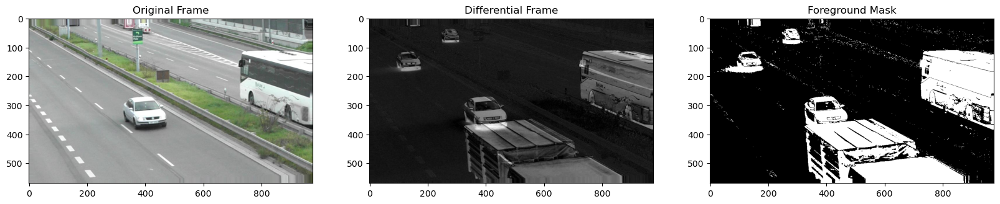

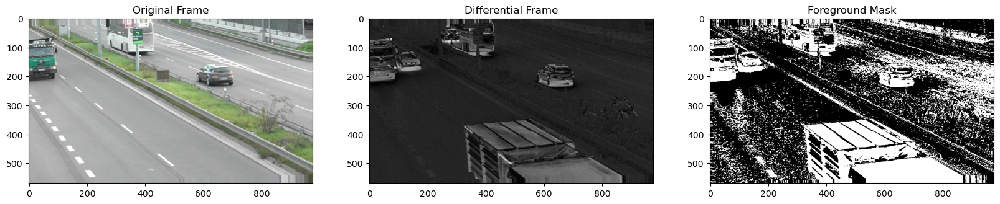

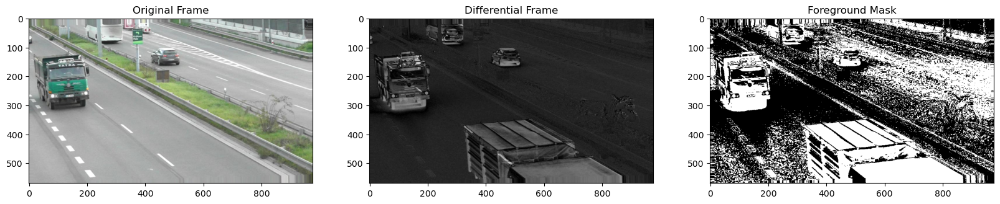

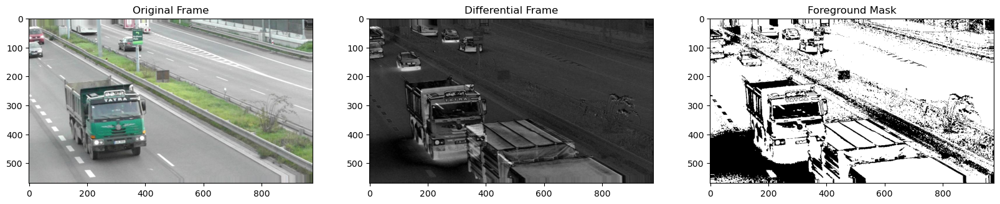

...

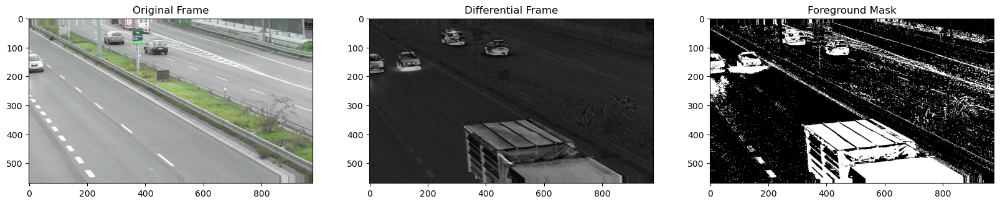

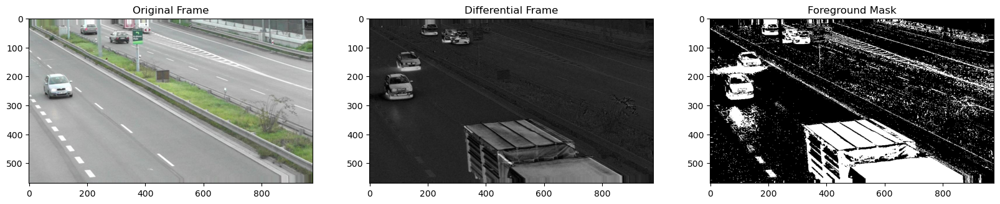

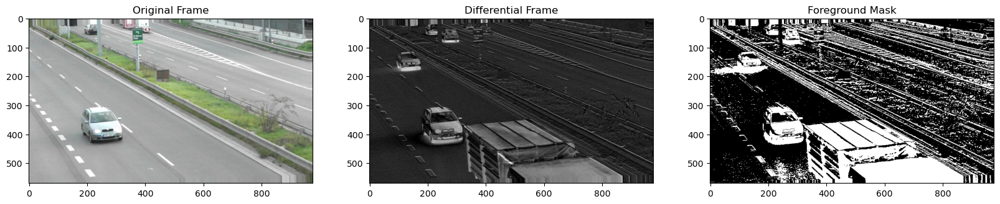

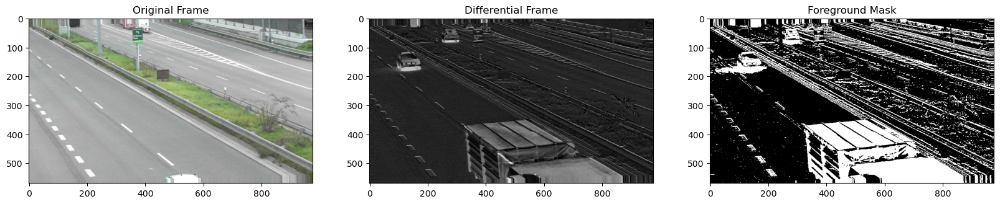

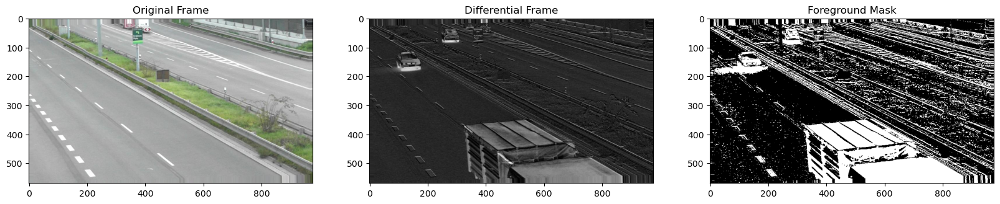

In [9]:
bg_frame = cv2.imread(frame_files[0])

bg_frame_gray = cv2.cvtColor(bg_frame, cv2.COLOR_BGR2GRAY).astype(np.float32)

for frame_file in frame_files[1:]:

    frame = cv2.imread(frame_file)
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY).astype(np.float32)
    
    diff = cv2.absdiff(gray_frame, bg_frame_gray).astype(np.uint8)
    
    _, fg_mask = cv2.threshold(diff, 30, 255, cv2.THRESH_BINARY)
    
    _, axes = plt.subplots(1, 3, figsize=(20, 8))
    axes[0].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Frame')

    axes[1].imshow(diff, cmap='gray')
    axes[1].set_title('Differential Frame')

    axes[2].imshow(fg_mask, cmap='gray')
    axes[2].set_title('Foreground Mask')

# Adaptive Background Subtraction with Gaussian Mixture Models (GMM)

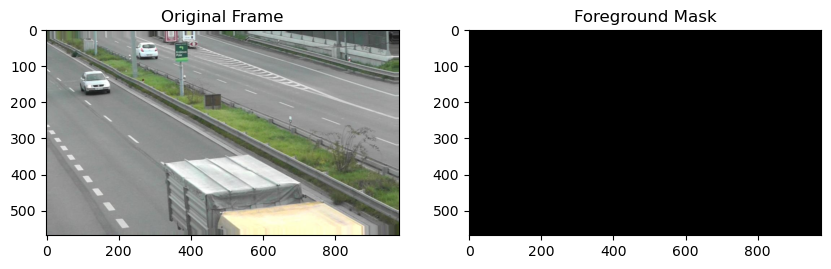

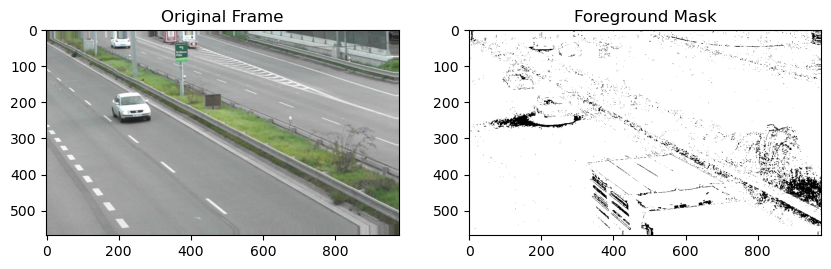

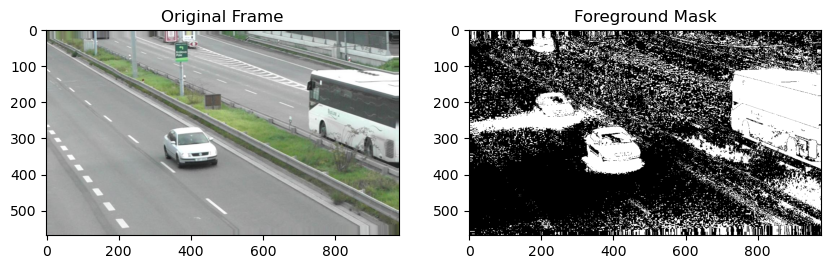

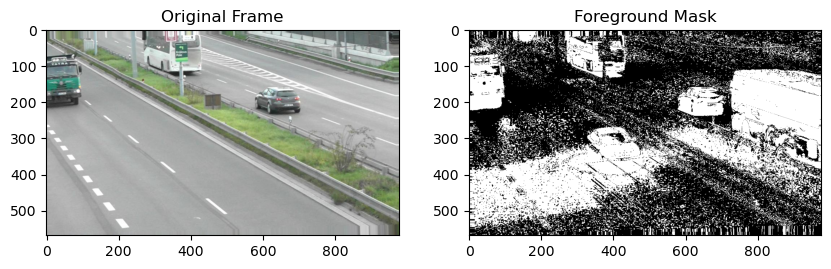

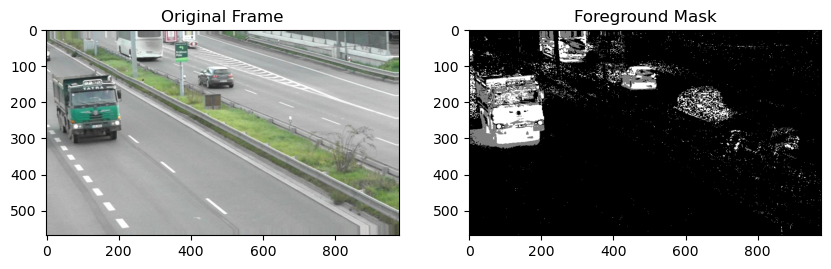

...

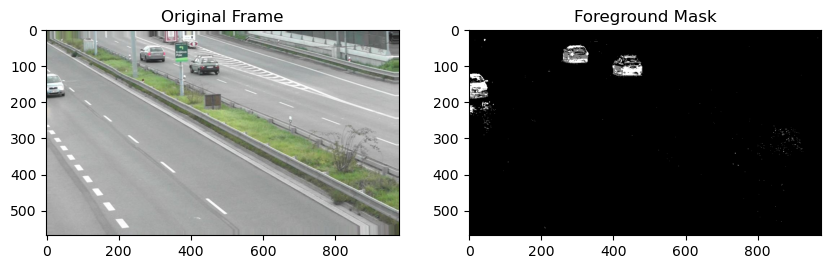

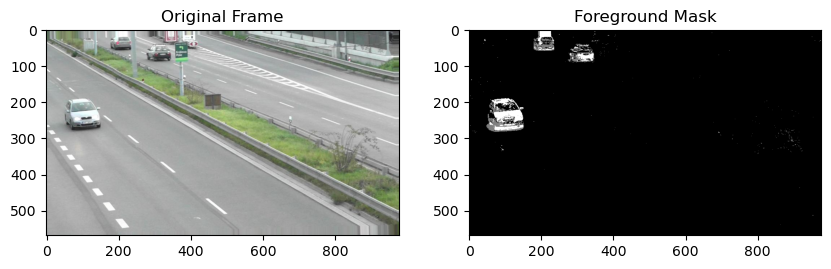

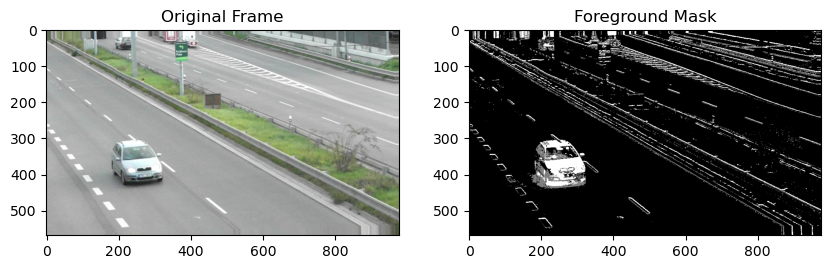

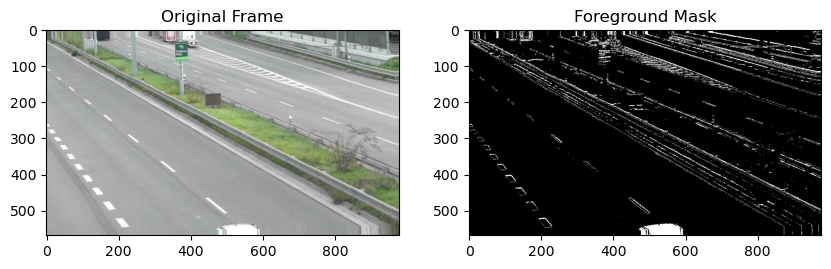

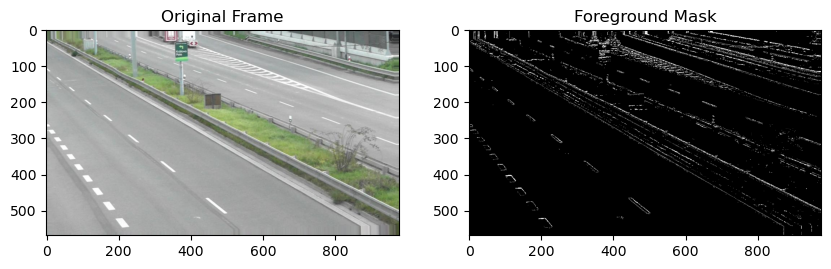

In [10]:
bg_subtractor = cv2.createBackgroundSubtractorMOG2()

first_frame = cv2.imread(frame_files[0])
bg_subtractor.apply(first_frame)

for frame_file in frame_files:
    frame = cv2.imread(frame_file)
    
    fg_mask = bg_subtractor.apply(frame)
    
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Frame')

    axes[1].imshow(fg_mask, cmap='gray')
    axes[1].set_title('Foreground Mask')

# Contour Detection

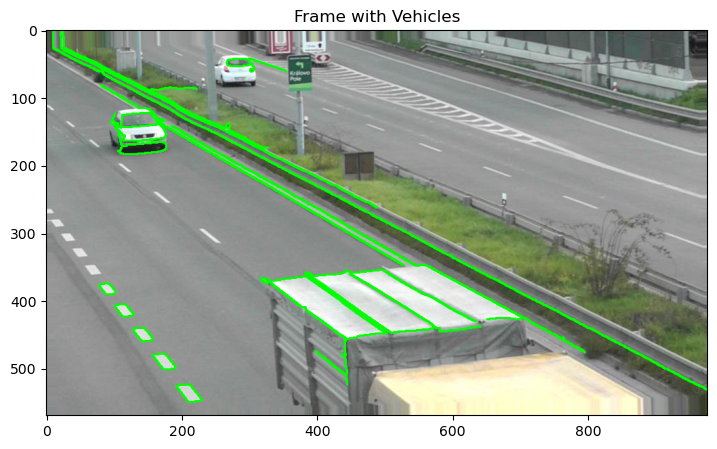

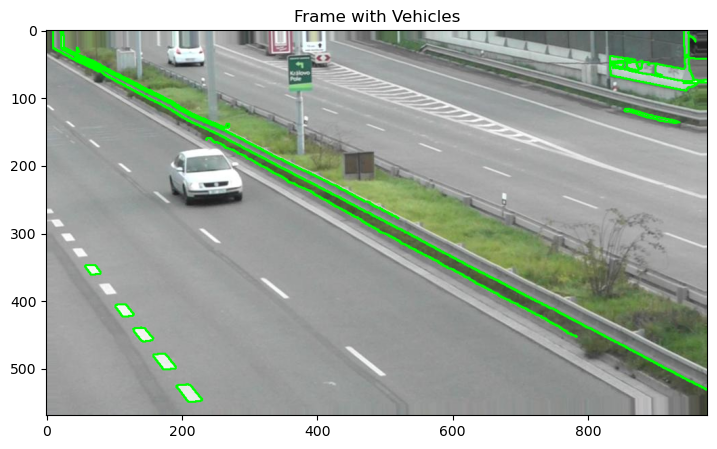

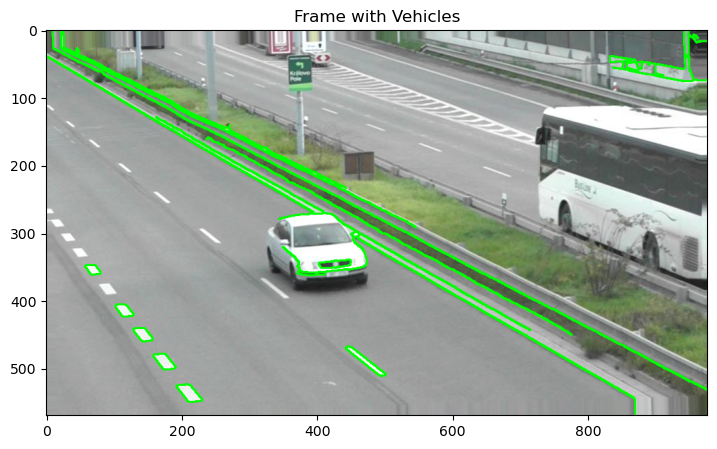

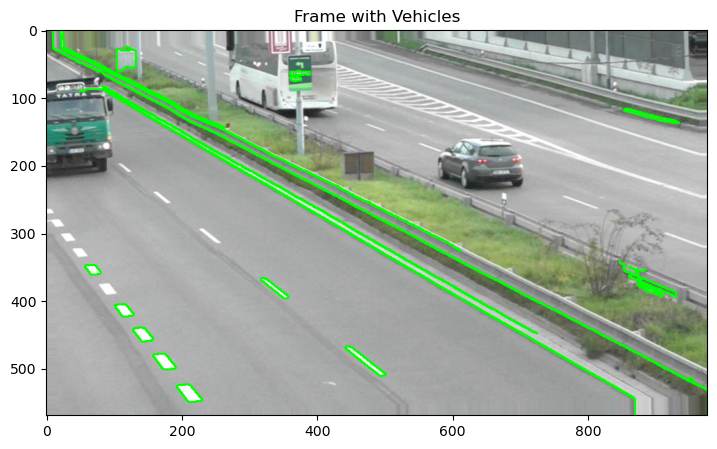

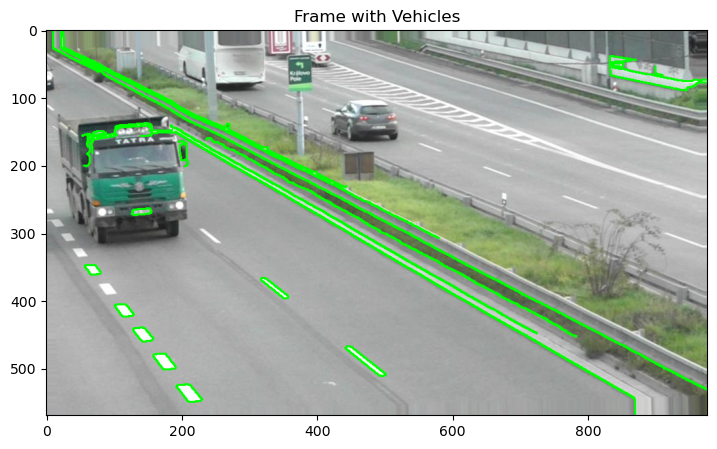

...

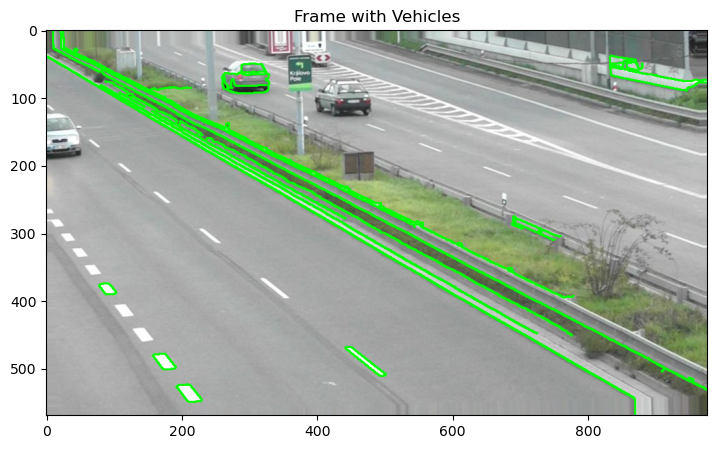

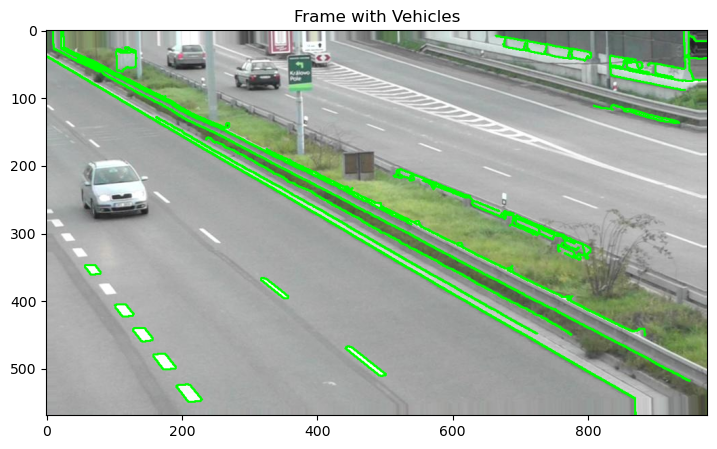

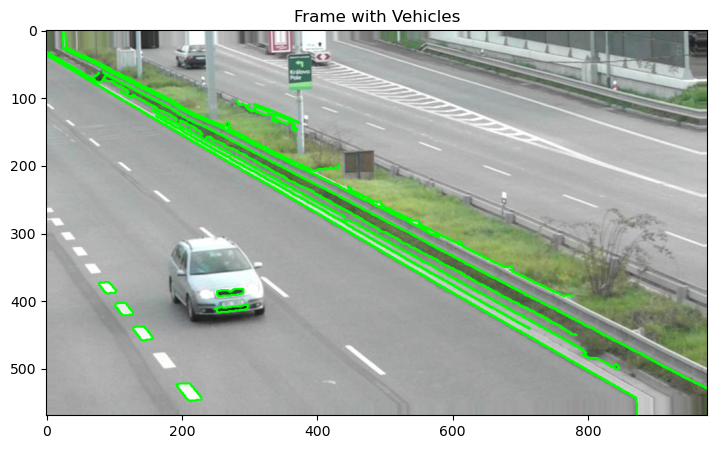

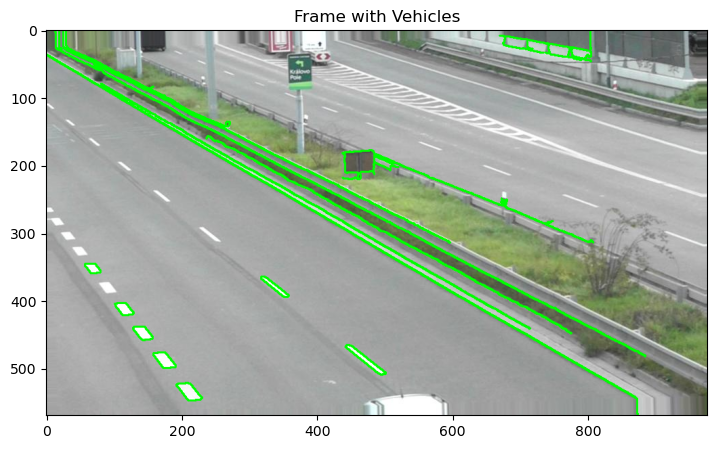

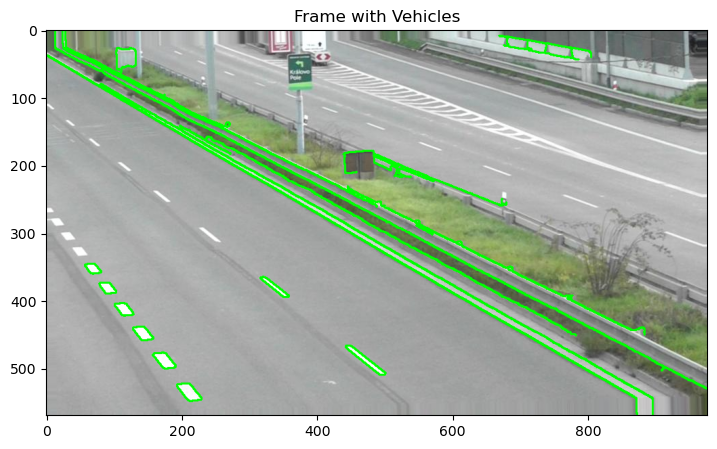

In [11]:
min_area_threshold = 200
max_area_threshold = 1000  
for frame_file in frame_files:

    frame = cv2.imread(frame_file)
    
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    blurred_frame = cv2.GaussianBlur(gray_frame, (5, 5), 0)
    
    edges = cv2.Canny(blurred_frame, 50, 150)
    
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    vehicles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        if min_area_threshold < area < max_area_threshold:
            vehicles.append(contour)
    
    frame_with_vehicles = frame.copy()
    cv2.drawContours(frame_with_vehicles, vehicles, -1, (0, 255, 0), 2)
    
    plt.figure(figsize=(10, 5))
    plt.imshow(cv2.cvtColor(frame_with_vehicles, cv2.COLOR_BGR2RGB))
    plt.title('Frame with Vehicles')


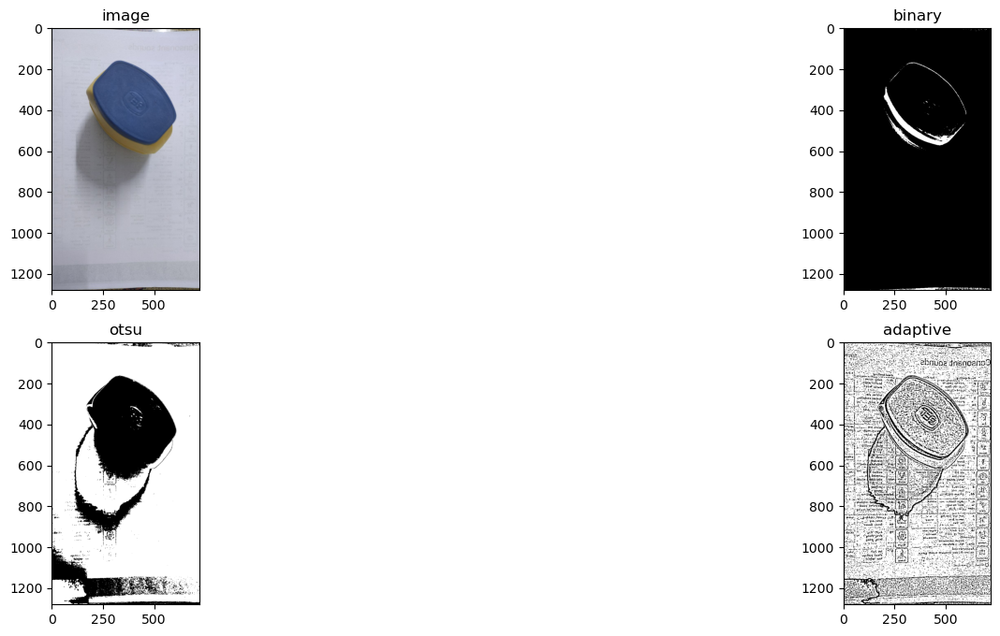

In [12]:
img_gray = cv2.cvtColor(final_result_img,cv2.COLOR_BGR2GRAY)

_,thresh_binary = cv2.threshold(img_gray,127,255,cv2.THRESH_BINARY_INV)
_, thresh_otsu = cv2.threshold(img_gray, 127, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
thresh_adaptive = cv2.adaptiveThreshold(img_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

plt.figure(figsize=(20,8))

plt.subplot(2,2,1)
plt.title('image')
plt.imshow(img,cmap='gray')

plt.subplot(2,2,2)
plt.title('binary')
plt.imshow(thresh_binary,cmap='gray')

plt.subplot(2,2,3)
plt.title('otsu')
plt.imshow(thresh_otsu,cmap='gray')

plt.subplot(2,2,4)
plt.title('adaptive')
plt.imshow(thresh_adaptive,cmap='gray')

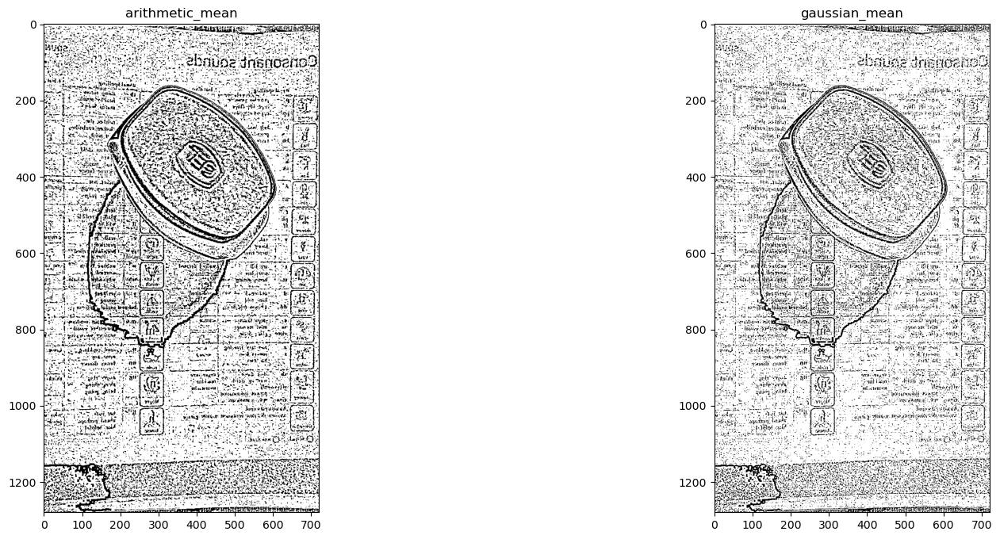

In [13]:
thresh_arithmetic = cv2.adaptiveThreshold(img_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)
thresh_gaussian = cv2.adaptiveThreshold(img_gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
plt.title('arithmetic_mean')
plt.imshow(thresh_arithmetic,cmap='gray')

plt.subplot(1,2,2)
plt.title('gaussian_mean')
plt.imshow(thresh_gaussian,cmap='gray')